# Open Meteo 

# Installation

In [50]:
# sources 
# https://open-meteo.com/en/docs/historical-weather-api#hourly=temperature_2m,relative_humidity_2m,dew_point_2m

In [55]:
!pip install openmeteo-requests
!pip install requests-cache retry-requests numpy pandas
!pip install geopy


[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python3.11 -m pip install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python3.11 -m pip install --upgrade pip
  Obtaining dependency information for geopy from https://files.pythonhosted.org/packages/e5/15/cf2a69ade4b194aa524ac75112d5caac37414b20a3a03e6865dfe0bd1539/geopy-2.4.1-py3-none-any.whl.metadata
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.3/40.3 kB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 125.4/125.4 kB 4.5 MB/s eta 0:00:00

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python3.11 -m pip install --upgrade pip


In [2]:
import openmeteo_requests
import requests_cache
import pandas as pd
from retry_requests import retry
from datetime import date, datetime
from dateutil.relativedelta import relativedelta

import requests
import urllib.parse
from geopy.geocoders import Nominatim


# Get longitude latitude

In [3]:
COUNTRY_CODES = {"portugal":[38.736946, -9.142685],
                "sacramento":[38.575764, -121.478851],
                "san_franisco":[24.828920500000002, -110.57782796000993]}

TODAY = datetime.utcnow().strftime("%Y-%m-%d")
LATITUDE, LONGITUDE = 38.736946, -9.142685
HISTORICAL_DATA = 10 
START_DATE = (datetime.utcnow() - relativedelta(years=HISTORICAL_DATA)).strftime("%Y-%m-%d")
END_DATE = datetime.utcnow().strftime("%Y-%m-%d")

In [83]:
def get_lan_long(location):
    
    # Initialize Nominatim API
    geolocator = Nominatim(user_agent="MyApp")
    location = geolocator.geocode(location)
    print("{} latitude\n{} longitude".format(location.latitude, location.longitude))
    
    return location.latitude, location.longitude


In [85]:
def get_lan_long(location):
    
    # Initialize Nominatim API
    geolocator = Nominatim(user_agent="MyApp")
    location = geolocator.geocode(location)
    print("{} latitude\n{} longitude".format(location.latitude, location.longitude))
    
    return location.latitude, location.longitude


LATITUDE, LONGITUDE = get_lan_long("Lisbon, Portugal")


# Setup the Open-Meteo API client with cache and retry on error
cache_session = requests_cache.CachedSession('.cache', expire_after = -1)
retry_session = retry(cache_session, retries = 5, backoff_factor = 0.2)
openmeteo = openmeteo_requests.Client(session = retry_session)

# Make sure all required weather variables are listed here
# The order of variables in hourly or daily is important to assign them correctly below
url = "https://archive-api.open-meteo.com/v1/archive"
params = {
	"latitude": LATITUDE,
	"longitude": LONGITUDE,
	"start_date": START_DATE,
	"end_date": TODAY,
	"hourly": ["temperature_2m", "relative_humidity_2m", "dew_point_2m", "rain", "wind_speed_10m", "wind_speed_100m", "wind_direction_10m", "wind_direction_100m", "wind_gusts_10m", "soil_temperature_0_to_7cm", "soil_temperature_7_to_28cm", "soil_temperature_28_to_100cm", "soil_temperature_100_to_255cm", "soil_moisture_0_to_7cm", "soil_moisture_7_to_28cm", "soil_moisture_28_to_100cm", "soil_moisture_100_to_255cm", "shortwave_radiation", "direct_radiation", "diffuse_radiation", "direct_normal_irradiance", "terrestrial_radiation", "shortwave_radiation_instant", "direct_radiation_instant", "diffuse_radiation_instant", "direct_normal_irradiance_instant", "terrestrial_radiation_instant"]
}
responses = openmeteo.weather_api(url, params=params)

# Process first location. Add a for-loop for multiple locations or weather models
response = responses[0]
print(f"Coordinates {response.Latitude()}°E {response.Longitude()}°N")
print(f"Elevation {response.Elevation()} m asl")
print(f"Timezone {response.Timezone()} {response.TimezoneAbbreviation()}")
print(f"Timezone difference to GMT+0 {response.UtcOffsetSeconds()} s")

# Process hourly data. The order of variables needs to be the same as requested.
hourly = response.Hourly()
hourly_temperature_2m = hourly.Variables(0).ValuesAsNumpy()
hourly_relative_humidity_2m = hourly.Variables(1).ValuesAsNumpy()
hourly_dew_point_2m = hourly.Variables(2).ValuesAsNumpy()
hourly_rain = hourly.Variables(3).ValuesAsNumpy()
hourly_wind_speed_10m = hourly.Variables(4).ValuesAsNumpy()
hourly_wind_speed_100m = hourly.Variables(5).ValuesAsNumpy()
hourly_wind_direction_10m = hourly.Variables(6).ValuesAsNumpy()
hourly_wind_direction_100m = hourly.Variables(7).ValuesAsNumpy()
hourly_wind_gusts_10m = hourly.Variables(8).ValuesAsNumpy()
hourly_soil_temperature_0_to_7cm = hourly.Variables(9).ValuesAsNumpy()
hourly_soil_temperature_7_to_28cm = hourly.Variables(10).ValuesAsNumpy()
hourly_soil_temperature_28_to_100cm = hourly.Variables(11).ValuesAsNumpy()
hourly_soil_temperature_100_to_255cm = hourly.Variables(12).ValuesAsNumpy()
hourly_soil_moisture_0_to_7cm = hourly.Variables(13).ValuesAsNumpy()
hourly_soil_moisture_7_to_28cm = hourly.Variables(14).ValuesAsNumpy()
hourly_soil_moisture_28_to_100cm = hourly.Variables(15).ValuesAsNumpy()
hourly_soil_moisture_100_to_255cm = hourly.Variables(16).ValuesAsNumpy()
hourly_shortwave_radiation = hourly.Variables(17).ValuesAsNumpy()
hourly_direct_radiation = hourly.Variables(18).ValuesAsNumpy()
hourly_diffuse_radiation = hourly.Variables(19).ValuesAsNumpy()
hourly_direct_normal_irradiance = hourly.Variables(20).ValuesAsNumpy()
hourly_terrestrial_radiation = hourly.Variables(21).ValuesAsNumpy()
hourly_shortwave_radiation_instant = hourly.Variables(22).ValuesAsNumpy()
hourly_direct_radiation_instant = hourly.Variables(23).ValuesAsNumpy()
hourly_diffuse_radiation_instant = hourly.Variables(24).ValuesAsNumpy()
hourly_direct_normal_irradiance_instant = hourly.Variables(25).ValuesAsNumpy()
hourly_terrestrial_radiation_instant = hourly.Variables(26).ValuesAsNumpy()

hourly_data = {"date": pd.date_range(
	start = pd.to_datetime(hourly.Time(), unit = "s"),
	end = pd.to_datetime(hourly.TimeEnd(), unit = "s"),
	freq = pd.Timedelta(seconds = hourly.Interval()),
	inclusive = "left"
)}
hourly_data["temperature_2m"] = hourly_temperature_2m
hourly_data["relative_humidity_2m"] = hourly_relative_humidity_2m
hourly_data["dew_point_2m"] = hourly_dew_point_2m
hourly_data["rain"] = hourly_rain
hourly_data["wind_speed_10m"] = hourly_wind_speed_10m
hourly_data["wind_speed_100m"] = hourly_wind_speed_100m
hourly_data["wind_direction_10m"] = hourly_wind_direction_10m
hourly_data["wind_direction_100m"] = hourly_wind_direction_100m
hourly_data["wind_gusts_10m"] = hourly_wind_gusts_10m
hourly_data["soil_temperature_0_to_7cm"] = hourly_soil_temperature_0_to_7cm
hourly_data["soil_temperature_7_to_28cm"] = hourly_soil_temperature_7_to_28cm
hourly_data["soil_temperature_28_to_100cm"] = hourly_soil_temperature_28_to_100cm
hourly_data["soil_temperature_100_to_255cm"] = hourly_soil_temperature_100_to_255cm
hourly_data["soil_moisture_0_to_7cm"] = hourly_soil_moisture_0_to_7cm
hourly_data["soil_moisture_7_to_28cm"] = hourly_soil_moisture_7_to_28cm
hourly_data["soil_moisture_28_to_100cm"] = hourly_soil_moisture_28_to_100cm
hourly_data["soil_moisture_100_to_255cm"] = hourly_soil_moisture_100_to_255cm
hourly_data["shortwave_radiation"] = hourly_shortwave_radiation
hourly_data["direct_radiation"] = hourly_direct_radiation
hourly_data["diffuse_radiation"] = hourly_diffuse_radiation
hourly_data["direct_normal_irradiance"] = hourly_direct_normal_irradiance
hourly_data["terrestrial_radiation"] = hourly_terrestrial_radiation
hourly_data["shortwave_radiation_instant"] = hourly_shortwave_radiation_instant
hourly_data["direct_radiation_instant"] = hourly_direct_radiation_instant
hourly_data["diffuse_radiation_instant"] = hourly_diffuse_radiation_instant
hourly_data["direct_normal_irradiance_instant"] = hourly_direct_normal_irradiance_instant
hourly_data["terrestrial_radiation_instant"] = hourly_terrestrial_radiation_instant

hourly_dataframe = pd.DataFrame(data = hourly_data)

38.7077507 latitude
-9.1365919 longitude
Coordinates 38.69947052001953°E -9.1961669921875°N
Elevation 7.0 m asl
Timezone None None
Timezone difference to GMT+0 0 s


In [82]:
hourly_dataframe

,date,temperature_2m,relative_humidity_2m,dew_point_2m,rain,wind_speed_10m,wind_speed_100m,wind_direction_10m,wind_direction_100m,wind_gusts_10m,...,shortwave_radiation,direct_radiation,diffuse_radiation,direct_normal_irradiance,terrestrial_radiation,shortwave_radiation_instant,direct_radiation_instant,diffuse_radiation_instant,direct_normal_irradiance_instant,terrestrial_radiation_instant
0,2013-12-18 00:00:00,10.124,91.637131,8.824,0.0,8.788720,11.019764,304.992096,308.367523,13.679999,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2013-12-18 01:00:00,10.074,91.324890,8.724,0.0,6.792466,9.000000,302.005341,306.869965,12.240000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2013-12-18 02:00:00,10.374,92.272461,9.174,0.0,4.693825,6.214563,265.601379,280.007904,9.720000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2013-12-18 03:00:00,10.324,93.520096,9.324,0.0,8.311245,10.086427,265.030334,267.954651,9.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2013-12-18 04:00:00,10.224,93.830353,9.274,0.0,9.746631,13.363711,274.236328,274.635376,10.440001,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
87667,2023-12-18 19:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0
87668,2023-12-18 20:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0
87669,2023-12-18 21:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0
87670,2023-12-18 22:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0


# Overview

In [14]:
import matplotlib.pyplot as plt
import seaborn as sns 
import matplotlib.pyplot as plt
from matplotlib.widgets import Slider

/usr/local/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: MatplotlibDeprecationWarning:

savefig() got unexpected keyword argument "orientation" which is no longer supported as of 3.3 and will become an error two minor releases later

/usr/local/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: MatplotlibDeprecationWarning:

savefig() got unexpected keyword argument "dpi" which is no longer supported as of 3.3 and will become an error two minor releases later

/usr/local/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: MatplotlibDeprecationWarning:

savefig() got unexpected keyword argument "facecolor" which is no longer supported as of 3.3 and will become an error two minor releases later

/usr/local/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: MatplotlibDeprecationWarning:

savefig() got unexpected keyword argument "edgecolor" which is no longer supported as of 3.3 and will become an error two minor releases later

/usr/local/lib/p

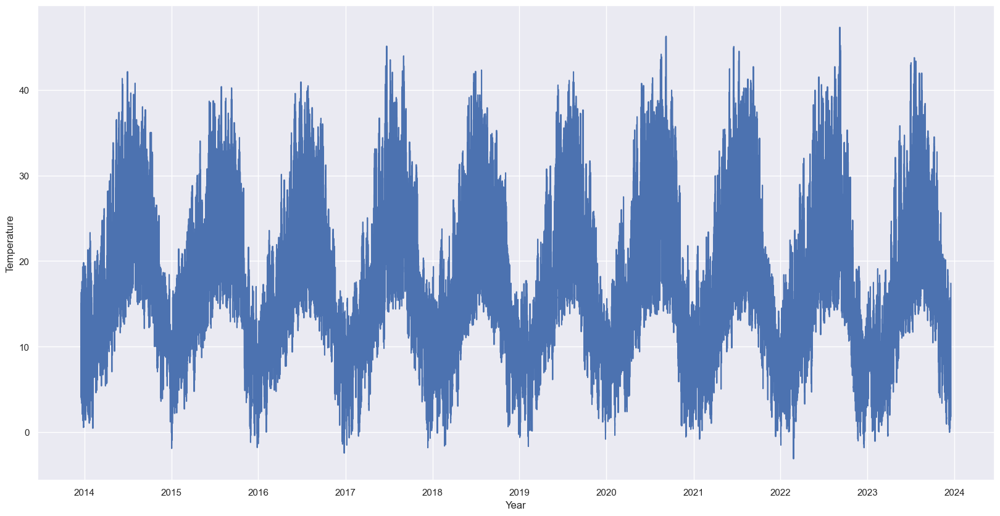

In [28]:
sns.lineplot(data=hourly_dataframe, x="date", y="temperature_2m")
sns.set_theme()
plt.ylabel("Temperature")
plt.xlabel("Year")
plt.rcParams["figure.figsize"] = (20,20)
plt.show();

# Visualisation

## Temperature Data

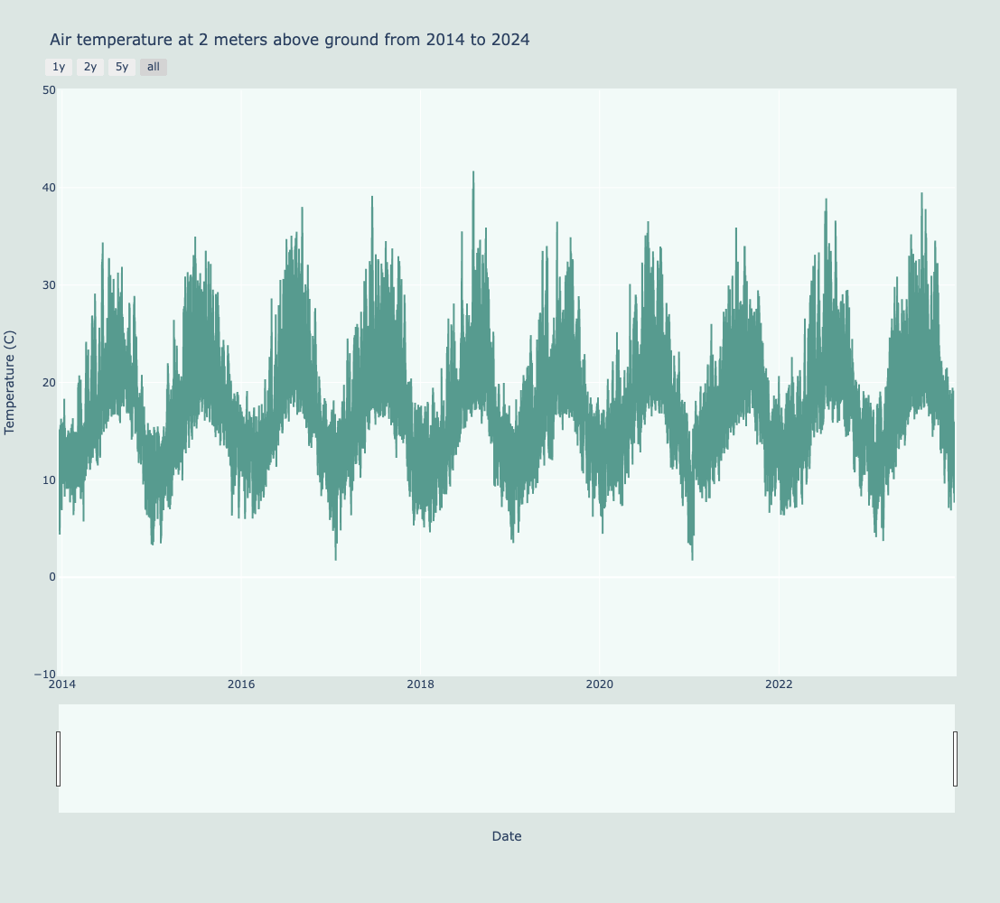

In [86]:
import plotly.express as px

# Your DataFrame and fig creation code remains the same...

fig = px.line(hourly_dataframe, x='date', y='temperature_2m', title='Air temperature at 2 meters above ground from 2014 to 2024', 
             labels={"date":"Date", "temperature_2m":"Temperature (C)"})

fig.update_traces(line=dict(color='#579B8F'))  # Update line color

# Update layout for better readability
fig.update_layout(
    xaxis_rangeslider_visible=True,
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1, label="1y", step="year", stepmode="backward"),
                dict(count=2, label="2y", step="year", stepmode="backward"),
                dict(count=5, label="5y", step="year", stepmode="backward"),
                dict(step="all")
            ])
        ),
        type="date"
    ),
    yaxis=dict(range=[-10, 50]),
    plot_bgcolor='#f2faf8',  # Set plot background color
    paper_bgcolor='#dce6e3',  # Set paper (overall figure) background color
    autosize=False,
    width=1000,
    height=1000,
    margin=dict(
        l=50,
        r=50,
        b=100,
        t=100,
        pad=2
    )
)

fig.show()

## Humidity

In [87]:
def create_fig(fig, y_min, y_max): 
    fig.update_traces(line=dict(color='#579B8F'))  # Update line color

    # Update layout for better readability
    fig.update_layout(
        xaxis_rangeslider_visible=True,
        xaxis=dict(
            rangeselector=dict(
                buttons=list([
                    dict(count=1, label="1y", step="year", stepmode="backward"),
                    dict(count=2, label="2y", step="year", stepmode="backward"),
                    dict(count=5, label="5y", step="year", stepmode="backward"),
                    dict(step="all")
                ])
            ),
            type="date"
        ),
        yaxis=dict(range=[y_min, y_max]),
        plot_bgcolor='#f2faf8',  # Set plot background color
        paper_bgcolor='#dce6e3',  # Set paper (overall figure) background color
        autosize=False,
        width=1000,
        height=1000,
        margin=dict(
            l=50,
            r=50,
            b=100,
            t=100,
            pad=2
        )
    )

    return fig


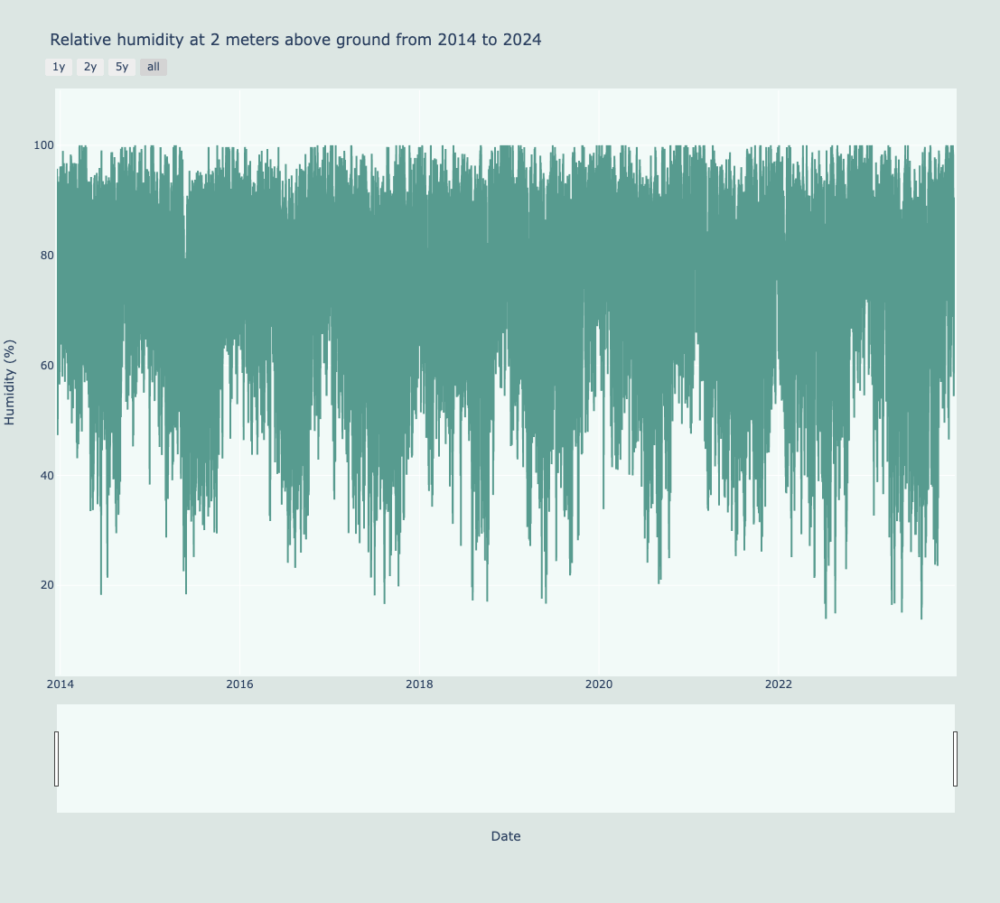

In [88]:
import plotly.express as px
margin = 10

y_col = 'relative_humidity_2m'

# Assuming 'hourly_dataframe' is your DataFrame with 'date' and 'temperature_2m' columns
fig = px.line(hourly_dataframe, x='date', y=y_col, title='Relative humidity at 2 meters above ground from 2014 to 2024', 
             labels={"date":"Date", "relative_humidity_2m":"Humidity (%)"})

y_col = 'relative_humidity_2m'
y_min, y_max = min(hourly_dataframe[y_col])-margin, max(hourly_dataframe[y_col]+margin) 

create_fig(fig, y_min, y_max)

fig.show()

## Direct Radiation

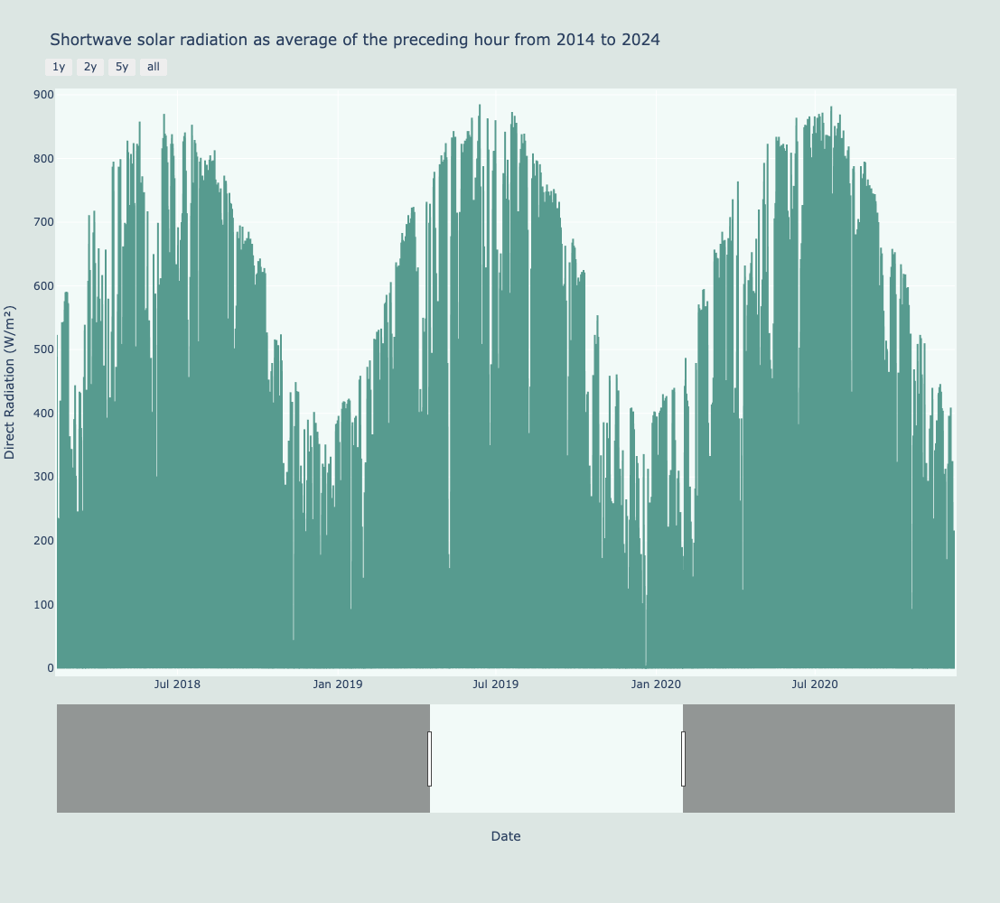

In [90]:
y_col = 'direct_radiation'

# Assuming 'hourly_dataframe' is your DataFrame with 'date' and 'temperature_2m' columns
fig = px.line(hourly_dataframe, x='date', y=y_col, title='Shortwave solar radiation as average of the preceding hour from 2014 to 2024', 
             labels={"date":"Date", "direct_radiation":"Direct Radiation (W/m²)"})

y_min, y_max = min(hourly_dataframe[y_col])-margin, max(hourly_dataframe[y_col]+margin) 

create_fig(fig, y_min, y_max)

fig.show()

## Soil

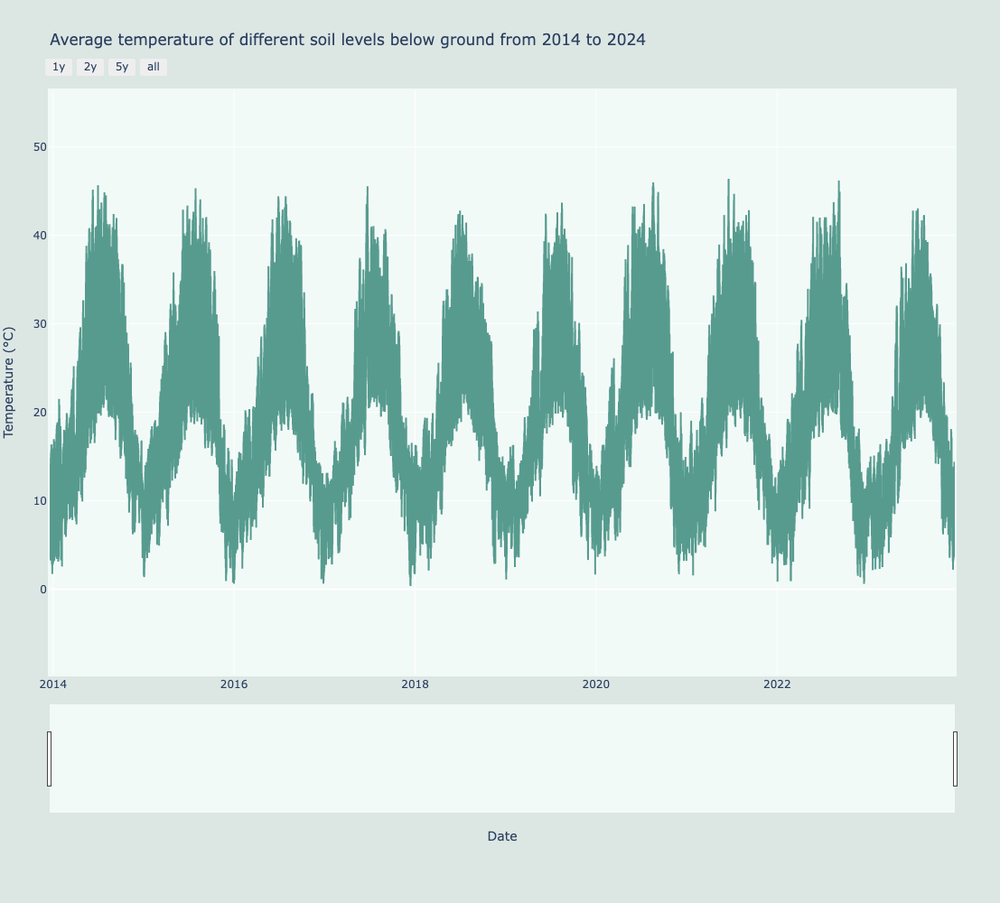

In [79]:
y_col = 'soil_temperature_0_to_7cm'

# Assuming 'hourly_dataframe' is your DataFrame with 'date' and 'temperature_2m' columns
fig = px.line(hourly_dataframe, x='date', y=y_col, title='Average temperature of different soil levels below ground from 2014 to 2024', 
             labels={"date":"Date", "soil_temperature_0_to_7cm":"Temperature (°C)"})


y_min, y_max = min(hourly_dataframe[y_col])-margin, max(hourly_dataframe[y_col]+margin) 

create_fig(fig, y_min, y_max)

fig.show()

# Prediction